In [119]:
import numpy as np
import matplotlib.pyplot as plt
import torch.nn as nn
import torch
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import torchvision.utils as vutils

In [120]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"The device in use is: {device}")

The device in use is: cuda


In [121]:
dataset = datasets.ImageFolder(root='./data_dcgan/',
                           transform=transforms.Compose([
                               transforms.Resize(64),
                               transforms.CenterCrop(64),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

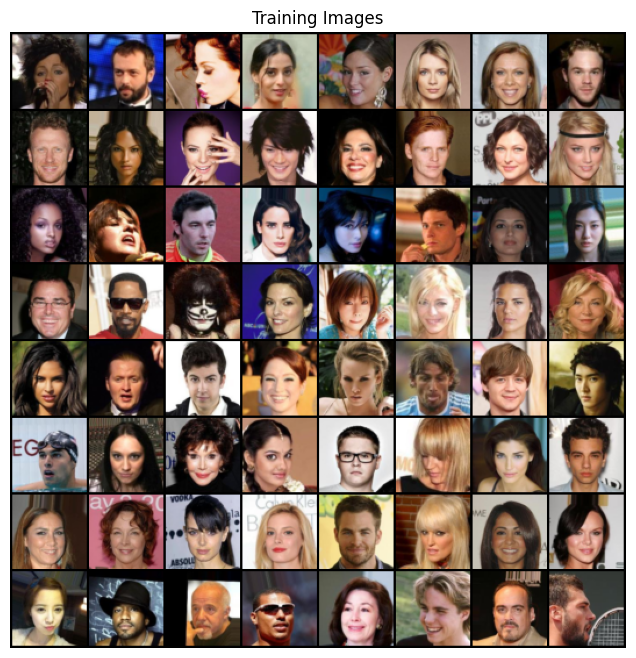

In [122]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=128,
                                         shuffle=True, num_workers=2)

real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [123]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.nz = 100
        self.ngf = 64


        self.model = nn.Sequential(

            nn.ConvTranspose2d(self.nz, self.ngf * 8, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(self.ngf * 8),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(self.ngf * 8, self.ngf * 4, 4, 2, 1),
            nn.BatchNorm2d(self.ngf * 4),
            nn.ReLU(True),

            nn.ConvTranspose2d(self.ngf * 4, self.ngf * 2, 4, 2, 1),
            nn.BatchNorm2d(self.ngf * 2),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(self.ngf * 2, self.ngf, 4, 2, 1),
            nn.BatchNorm2d(self.ngf),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(self.ngf, 3, 4, 2, 1),
            nn.Tanh()

      
        )
    
    def forward(self, z):
        return self.model(z)

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            # 3 x 64 x 64
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),

            # 32 x 32 x 32
            nn.Conv2d(64, 64 * 2, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64 * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # 64 x 16 x 16
            nn.Conv2d(64 * 2, 64 * 4, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64 * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # 128 x 8 x 8
            nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 256 x 4 x 4
            nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

generator = Generator().to(device)
discriminator = Discriminator().to(device)

In [124]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, 100, 1, 1, device=device)

real_labels = 1.
fake_labels = 0.

optimizerD = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))

In [125]:
img_list = []
G_losses = []
D_losses = []
iters = 0


for epoch in range(5):

    for i, (real_data, _) in enumerate(dataloader):

        # discriminator training
        discriminator.zero_grad()

        real_data = real_data.to(device)
        batch_size = real_data.shape[0]
        real_labels = torch.full((batch_size, ), 1, dtype=torch.float, device=device)

        output = discriminator(real_data).view(-1)
        error_real = criterion(output, real_labels)
        error_real.backward()

        D_x = output.mean().item()

        # Training the generator here, generate noise
        noise = torch.randn(batch_size, 100, 1, 1, device=device)
        fake_images = generator(noise)
        fake_labels = torch.full((batch_size, ), 0, dtype=torch.float, device=device)

        output = discriminator(fake_images.detach()).view(-1)
        error_fake = criterion(output, fake_labels)

        error_fake.backward()
        D_G_z1 = output.mean().item()

        error_discriminator = error_real + error_fake
        optimizerD.step()

        # Updating the genrator my minimizing log(1 - D)
        generator.zero_grad()
        label = torch.full((batch_size, ), 1, dtype=torch.float, device=device)
        output = discriminator(fake_images).view(-1)
        error_generator = criterion(output, label)
        error_generator.backward()

        D_G_z2 = output.mean().item()

        optimizerG.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, 5, i, len(dataloader),
                     error_discriminator.item(), error_generator.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(error_generator.item())
        D_losses.append(error_discriminator.item())


        if (iters % 500 == 0) or ((epoch == 4) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

[0/5][0/1583]	Loss_D: 1.5449	Loss_G: 2.2149	D(x): 0.4216	D(G(z)): 0.4753 / 0.1139
[0/5][50/1583]	Loss_D: 0.2340	Loss_G: 16.8114	D(x): 0.8518	D(G(z)): 0.0000 / 0.0000
[0/5][100/1583]	Loss_D: 1.1482	Loss_G: 3.4611	D(x): 0.4014	D(G(z)): 0.0160 / 0.0539
[0/5][150/1583]	Loss_D: 0.7272	Loss_G: 4.2698	D(x): 0.8639	D(G(z)): 0.4032 / 0.0173
[0/5][200/1583]	Loss_D: 0.6850	Loss_G: 3.5556	D(x): 0.5938	D(G(z)): 0.0802 / 0.0470
[0/5][250/1583]	Loss_D: 0.8049	Loss_G: 4.1110	D(x): 0.8045	D(G(z)): 0.3977 / 0.0249
[0/5][300/1583]	Loss_D: 0.8228	Loss_G: 3.1278	D(x): 0.7737	D(G(z)): 0.3799 / 0.0657
[0/5][350/1583]	Loss_D: 0.8901	Loss_G: 1.8244	D(x): 0.6443	D(G(z)): 0.3003 / 0.1903
[0/5][400/1583]	Loss_D: 0.4678	Loss_G: 2.6210	D(x): 0.7466	D(G(z)): 0.1342 / 0.0905
[0/5][450/1583]	Loss_D: 0.2915	Loss_G: 4.0111	D(x): 0.8626	D(G(z)): 0.1191 / 0.0258
[0/5][500/1583]	Loss_D: 0.7745	Loss_G: 5.3629	D(x): 0.9570	D(G(z)): 0.4853 / 0.0068
[0/5][550/1583]	Loss_D: 0.4654	Loss_G: 3.4769	D(x): 0.7515	D(G(z)): 0.1166 / 0

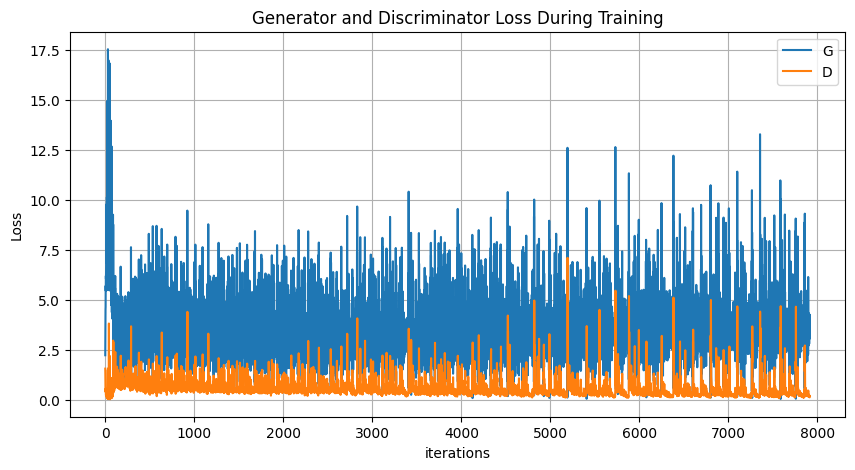

In [126]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.grid()
plt.legend()
plt.show()

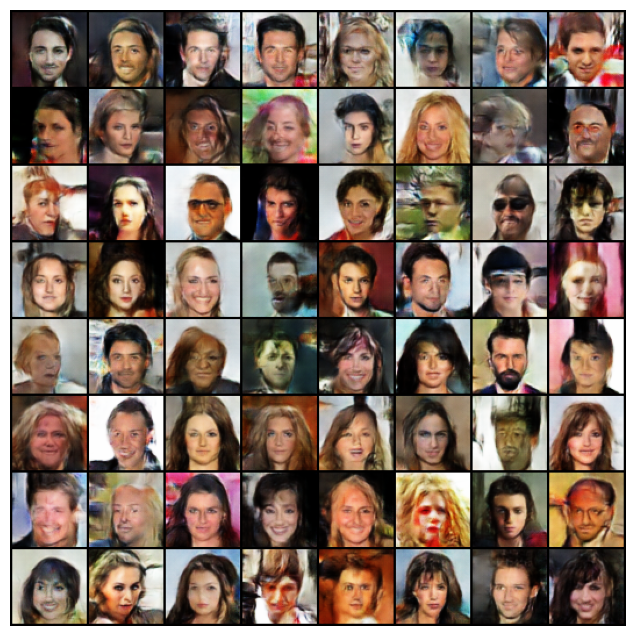

In [129]:
from matplotlib import animation
from IPython.display import HTML


fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())